# Setup


In [ ]:
!pip install pyyaml==5.1

import torch
TORCH_VERSION = ".".join(torch.__version__.split(".")[:2])
CUDA_VERSION = torch.__version__.split("+")[-1]
print("torch: ", TORCH_VERSION, "; cuda: ", CUDA_VERSION)
# Install detectron2 that matches the above pytorch version
# See https://detectron2.readthedocs.io/tutorials/install.html for instructions
# !pip install detectron2 -f https://dl.fbaipublicfiles.com/detectron2/wheels/$CUDA_VERSION/torch$TORCH_VERSION/index.html
# If there is not yet a detectron2 release that matches the given torch + CUDA version, you need to install a different pytorch.
!python -m pip install 'git+https://github.com/facebookresearch/detectron2.git'
# exit(0)  # After installation, you may need to "restart runtime" in Colab. This line can also restart runtime

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 274.2/274.2 kB 7.0 MB/s eta 0:00:00
  error: subprocess-exited-with-error
  
  × python setup.py egg_info did not run successfully.
  │ exit code: 1
  ╰─> See above for output.
  
  note: This error originates from a subprocess, and is likely not a problem with pip.
  Preparing metadata (setup.py) ... error
error: metadata-generation-failed

× Encountered error while generating package metadata.
╰─> See above for output.

note: This is an issue with the package mentioned above, not pip.
hint: See above for details.
torch:  2.3 ; cuda:  cu121
  Cloning https://github.com/facebookresearch/detectron2.git to /tmp/pip-req-build-iogg9bo3
  Running command git clone --filter=blob:none --quiet https://github.com/facebookresearch/detectron2.git /tmp/pip-req-build-iogg9bo3
  Resolved https://github.com/facebookresearch/detectron2.git to commit e8806d607403cf0f2634d4c5ac464109fdc7d4af
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
# Some basic setup:
# Setup detectron2 logger
import detectron2
from detectron2.utils.logger import setup_logger
setup_logger()

# import some common libraries
import numpy as np
import os, json, cv2, random
from google.colab.patches import cv2_imshow

# import some common detectron2 utilities
from detectron2 import model_zoo
from detectron2.engine import DefaultPredictor
from detectron2.config import get_cfg
from detectron2.utils.visualizer import Visualizer
from detectron2.data import MetadataCatalog, DatasetCatalog

# Import and Register Data

In [ ]:
from detectron2.data.datasets import register_coco_instances
register_coco_instances("my_dataset_train", {}, "/content/drive/MyDrive/cocopuffs/traincoco/combined/_annotations.coco.json", "/content/drive/MyDrive/cocopuffs/traincoco/combined")
register_coco_instances("my_dataset_test", {}, "/content/drive/MyDrive/cocopuffs/testcoco/combined/_annotations.coco.json", "/content/drive/MyDrive/cocopuffs/testcoco/combined")
register_coco_instances("my_dataset_valid", {}, "/content/drive/MyDrive/cocopuffs/validcoco/combined/_annotations.coco.json", "/content/drive/MyDrive/cocopuffs/validcoco/combined")

WARNING [06/16 18:16:30 d2.data.datasets.coco]: 
Category ids in annotations are not in [1, #categories]! We'll apply a mapping for you.

[06/16 18:16:30 d2.data.datasets.coco]: Loaded 326 images in COCO format from /content/drive/MyDrive/cocopuffs/traincoco/combined/_annotations.coco.json


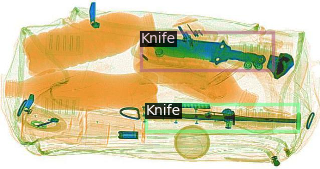

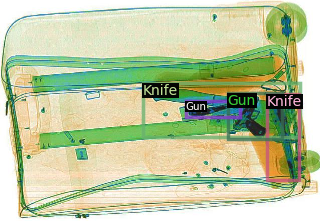

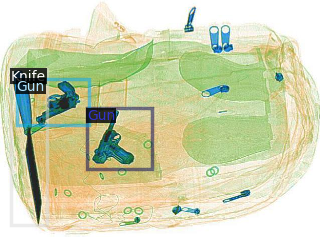

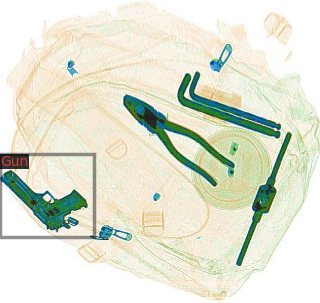

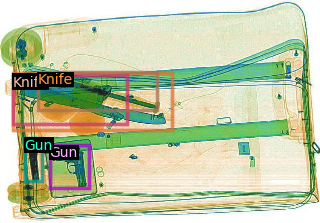

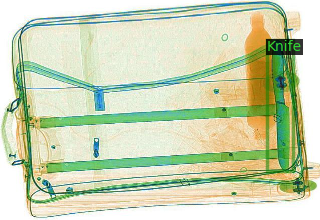

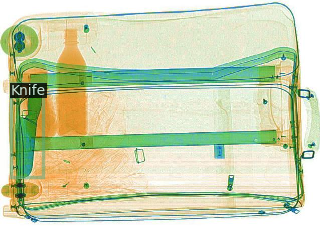

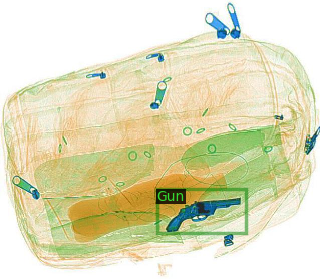

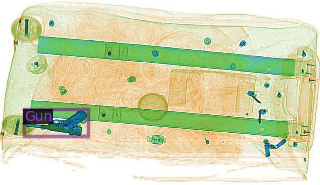

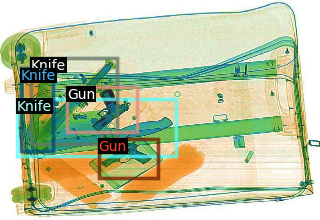

In [ ]:
#visualize training data
my_dataset_train_metadata = MetadataCatalog.get("my_dataset_train")
dataset_dicts = DatasetCatalog.get("my_dataset_train")

import random
from detectron2.utils.visualizer import Visualizer

for d in random.sample(dataset_dicts, 10):
    img = cv2.imread(d["file_name"])
    visualizer = Visualizer(img[:, :, ::-1], metadata=my_dataset_train_metadata, scale=0.5)
    vis = visualizer.draw_dataset_dict(d)
    cv2_imshow(vis.get_image()[:, :, ::-1])

# Train Custom Detectron2 Detector

In [ ]:
from detectron2.engine import DefaultTrainer

# Create configuration
cfg = get_cfg()
# Load configuration from model zoo
cfg.merge_from_file(model_zoo.get_config_file("COCO-Detection/faster_rcnn_R_50_FPN_3x.yaml"))

cfg.DATASETS.TRAIN = ("my_dataset_train",)
cfg.DATASETS.TEST = ("my_dataset_valid",)  # For evaluation during training
cfg.DATALOADER.NUM_WORKERS = 2
cfg.MODEL.WEIGHTS = "detectron2://ImageNetPretrained/MSRA/R-101.pkl"  # ImageNet pre-trained weights
cfg.SOLVER.IMS_PER_BATCH = 2
cfg.SOLVER.BASE_LR = 0.01  # Learning rate
cfg.SOLVER.MAX_ITER = 5000  # Reduced number of iterations for testing
cfg.SOLVER.STEPS = []  # No learning rate decay
cfg.SOLVER.WEIGHT_DECAY = 0.0001
cfg.MODEL.ROI_HEADS.BATCH_SIZE_PER_IMAGE = 512  # (default: 512)
cfg.MODEL.ROI_HEADS.NUM_CLASSES = 3  # Number of classes (TIP, Gun, Knife)

#Save model
os.makedirs(cfg.OUTPUT_DIR, exist_ok=True)
trainer = DefaultTrainer(cfg)
trainer.resume_or_load(resume=True)
trainer.train()

[06/17 11:10:25 d2.engine.defaults]: Model:
GeneralizedRCNN(
  (backbone): FPN(
    (fpn_lateral2): Conv2d(256, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output2): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral3): Conv2d(512, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output3): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral4): Conv2d(1024, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output4): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral5): Conv2d(2048, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output5): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (top_block): LastLevelMaxPool()
    (bottom_up): ResNet(
      (stem): BasicStem(
        (conv1): Conv2d(
          3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False
          (norm): FrozenBatchNorm2d(num_features=64, eps=1e-05)
        )
      )
      (res

R-101.pkl: 179MB [00:00, 250MB/s]                           


[06/17 11:10:29 d2.checkpoint.c2_model_loading]: Renaming Caffe2 weights ......
[06/17 11:10:30 d2.checkpoint.c2_model_loading]: Following weights matched with submodule backbone.bottom_up - Total num: 54


backbone.fpn_lateral2.{bias, weight}
backbone.fpn_lateral3.{bias, weight}
backbone.fpn_lateral4.{bias, weight}
backbone.fpn_lateral5.{bias, weight}
backbone.fpn_output2.{bias, weight}
backbone.fpn_output3.{bias, weight}
backbone.fpn_output4.{bias, weight}
backbone.fpn_output5.{bias, weight}
proposal_generator.rpn_head.anchor_deltas.{bias, weight}
proposal_generator.rpn_head.conv.{bias, weight}
proposal_generator.rpn_head.objectness_logits.{bias, weight}
roi_heads.box_head.fc1.{bias, weight}
roi_heads.box_head.fc2.{bias, weight}
roi_heads.box_predictor.bbox_pred.{bias, weight}
roi_heads.box_predictor.cls_score.{bias, weight}
  fc1000.{bias, weight}
  res4.10.conv1.norm.{bias, running_mean, running_var, weight}
  res4.10.conv1.weight
  res4.10.conv2.norm.{bias, running_mean, running_var, weight}
  res4.10.conv2.weight
  res4.10.conv3.norm.{bias, running_mean, running_var, weight}
  res4.10.conv3.weight
  res4.11.conv1.norm.{bias, running_mean, running_var, weight}
  res4.11.conv1.weight


[06/17 11:10:30 d2.engine.train_loop]: Starting training from iteration 0


/usr/local/lib/python3.10/dist-packages/torch/functional.py:512: UserWarning: torch.meshgrid: in an upcoming release, it will be required to pass the indexing argument. (Triggered internally at ../aten/src/ATen/native/TensorShape.cpp:3587.)
  return _VF.meshgrid(tensors, **kwargs)  # type: ignore[attr-defined]


[06/17 11:10:54 d2.utils.events]:  eta: 1:18:20  iter: 19  total_loss: 0.8477  loss_cls: 0.06444  loss_box_reg: 0.0005294  loss_rpn_cls: 0.6966  loss_rpn_loc: 0.04157    time: 0.9911  last_time: 0.7969  data_time: 0.5543  last_data_time: 0.4246   lr: 0.00019981  max_mem: 2639M
[06/17 11:11:16 d2.utils.events]:  eta: 1:15:47  iter: 39  total_loss: 0.5733  loss_cls: 0.1174  loss_box_reg: 0.03997  loss_rpn_cls: 0.3889  loss_rpn_loc: 0.02919    time: 0.9703  last_time: 1.1169  data_time: 0.5418  last_data_time: 0.7258   lr: 0.00039961  max_mem: 2639M
[06/17 11:11:37 d2.utils.events]:  eta: 1:15:55  iter: 59  total_loss: 0.4089  loss_cls: 0.1481  loss_box_reg: 0.08294  loss_rpn_cls: 0.1298  loss_rpn_loc: 0.03397    time: 0.9965  last_time: 0.8170  data_time: 0.6143  last_data_time: 0.4844   lr: 0.00059941  max_mem: 2639M
[06/17 11:11:57 d2.utils.events]:  eta: 1:15:53  iter: 79  total_loss: 0.3502  loss_cls: 0.1334  loss_box_reg: 0.0971  loss_rpn_cls: 0.07426  loss_rpn_loc: 0.02792    time:

In [ ]:
# Look at training curves in tensorboard:
%load_ext tensorboard
%tensorboard --logdir output

<IPython.core.display.Javascript object>

In [ ]:
cfg.MODEL.WEIGHTS = os.path.join(cfg.OUTPUT_DIR, "model_final.pth")
cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.5   # set the testing threshold for this model
cfg.DATASETS.TEST = ("my_dataset_test", )
predictor = DefaultPredictor(cfg)

[06/17 11:52:24 d2.checkpoint.detection_checkpoint]: [DetectionCheckpointer] Loading from ./output/model_final.pth ...


# Predictions and Testing



In [ ]:
test_metadata = MetadataCatalog.get("my_dataset_test")

In [1]:
class_names = ['TIP', 'Gun', 'Knife'] # Replace with your actual class names


In [ ]:
from detectron2.data import MetadataCatalog

# Assuming your dataset name is "my_dataset_test"
test_metadata = MetadataCatalog.get("my_dataset_test")

# Add class names to the metadata
test_metadata.thing_classes = class_names



{'instances': Instances(num_instances=7, image_height=346, image_width=640, fields=[pred_boxes: Boxes(tensor([[ 51.9739,  99.1425, 235.6550, 167.5323],
        [ 32.2241,  87.5612,  58.7816, 166.3140],
        [ 71.5738, 255.3443, 134.4700, 280.6437],
        [ 55.7580, 230.4694, 269.7764, 257.6494],
        [ 28.6443, 182.2020,  98.1065, 229.0635],
        [ 18.6862, 229.2785, 378.4328, 261.6878],
        [ 81.3942, 258.2564, 131.1682, 271.6814]], device='cuda:0')), scores: tensor([0.9904, 0.9872, 0.9761, 0.9285, 0.9255, 0.8494, 0.6719],
       device='cuda:0'), pred_classes: tensor([2, 1, 1, 2, 1, 2, 1], device='cuda:0')])}


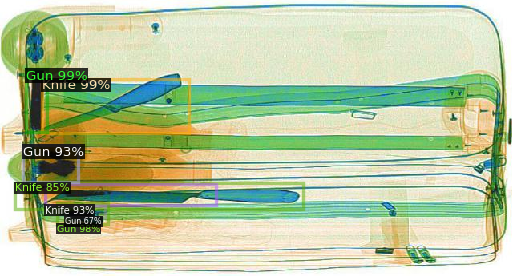

{'instances': Instances(num_instances=1, image_height=211, image_width=640, fields=[pred_boxes: Boxes(tensor([[287.5213,  21.2377, 418.8478,  72.0265]], device='cuda:0')), scores: tensor([0.9922], device='cuda:0'), pred_classes: tensor([2], device='cuda:0')])}


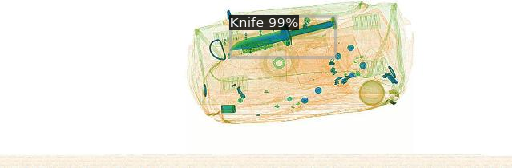

{'instances': Instances(num_instances=2, image_height=640, image_width=635, fields=[pred_boxes: Boxes(tensor([[ 42.7085, 387.0819, 184.2022, 520.2328],
        [ 24.1133, 386.2432, 183.7474, 636.9739]], device='cuda:0')), scores: tensor([0.9990, 0.9980], device='cuda:0'), pred_classes: tensor([1, 2], device='cuda:0')])}


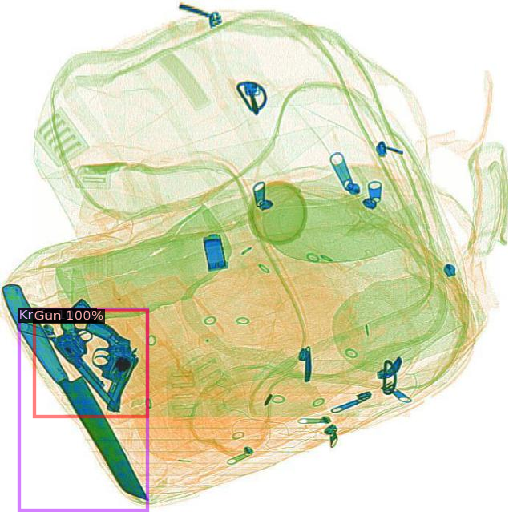

{'instances': Instances(num_instances=6, image_height=469, image_width=640, fields=[pred_boxes: Boxes(tensor([[449.5175, 330.6693, 517.6191, 400.6300],
        [550.7542, 323.3480, 578.6646, 393.8015],
        [283.6169, 189.0182, 587.8505, 270.6382],
        [320.5274, 186.3090, 579.6208, 228.0746],
        [339.0555, 220.0041, 591.1315, 263.7426],
        [326.7110, 187.4018, 485.7115, 218.1384]], device='cuda:0')), scores: tensor([0.9996, 0.9964, 0.9877, 0.9151, 0.7406, 0.5086], device='cuda:0'), pred_classes: tensor([1, 1, 2, 2, 2, 2], device='cuda:0')])}


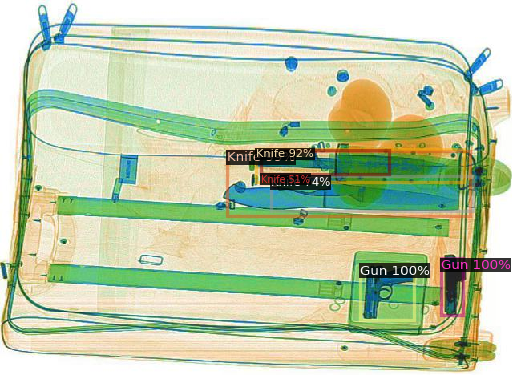

{'instances': Instances(num_instances=3, image_height=457, image_width=640, fields=[pred_boxes: Boxes(tensor([[511.9803, 249.3002, 597.1388, 341.5554],
        [268.3786, 164.0786, 587.6185, 201.7038],
        [384.5233, 344.1192, 561.8964, 418.9537]], device='cuda:0')), scores: tensor([0.9974, 0.9852, 0.9771], device='cuda:0'), pred_classes: tensor([1, 2, 2], device='cuda:0')])}


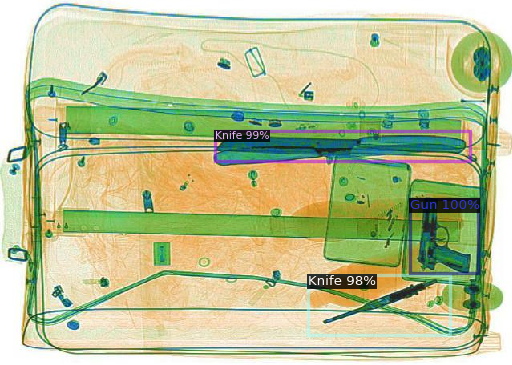

{'instances': Instances(num_instances=4, image_height=437, image_width=640, fields=[pred_boxes: Boxes(tensor([[ 87.1100, 180.8561, 157.1567, 249.5410],
        [ 44.8993, 156.3428,  75.1873, 232.1521],
        [ 79.5310, 287.4161, 313.2165, 351.1996],
        [ 56.4457, 198.4404, 333.2821, 363.8510]], device='cuda:0')), scores: tensor([0.9976, 0.9975, 0.9856, 0.9338], device='cuda:0'), pred_classes: tensor([1, 1, 2, 2], device='cuda:0')])}


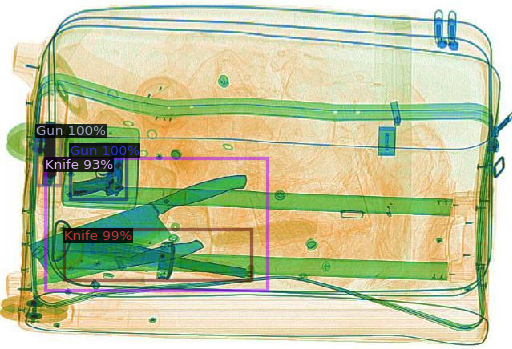

{'instances': Instances(num_instances=3, image_height=461, image_width=640, fields=[pred_boxes: Boxes(tensor([[483.9139, 116.9331, 576.4742, 266.7942],
        [414.1663, 242.8851, 613.2797, 337.9504],
        [230.1543, 349.2225, 614.8688, 411.4900]], device='cuda:0')), scores: tensor([0.9979, 0.9906, 0.9897], device='cuda:0'), pred_classes: tensor([1, 1, 2], device='cuda:0')])}


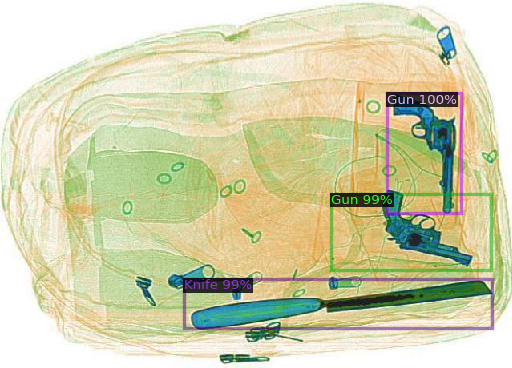

{'instances': Instances(num_instances=4, image_height=426, image_width=640, fields=[pred_boxes: Boxes(tensor([[ 96.4243, 266.6723, 178.2278, 350.6186],
        [ 46.6398, 265.0551,  82.9734, 364.0488],
        [ 48.6845, 147.7115, 266.1609, 225.3425],
        [ 69.5384, 137.0196, 318.1546, 199.6931]], device='cuda:0')), scores: tensor([0.9996, 0.9952, 0.9914, 0.7753], device='cuda:0'), pred_classes: tensor([1, 1, 2, 2], device='cuda:0')])}


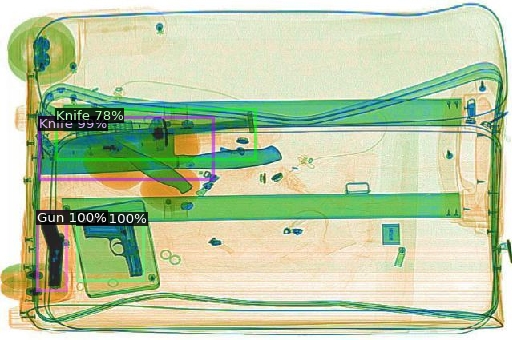

{'instances': Instances(num_instances=3, image_height=496, image_width=640, fields=[pred_boxes: Boxes(tensor([[ 29.0788, 334.8316, 337.9551, 478.0689],
        [ 43.2270, 184.9453, 188.5784, 282.2901],
        [ 78.7907, 180.9395, 173.9681, 340.8628]], device='cuda:0')), scores: tensor([0.9968, 0.9944, 0.9845], device='cuda:0'), pred_classes: tensor([2, 1, 1], device='cuda:0')])}


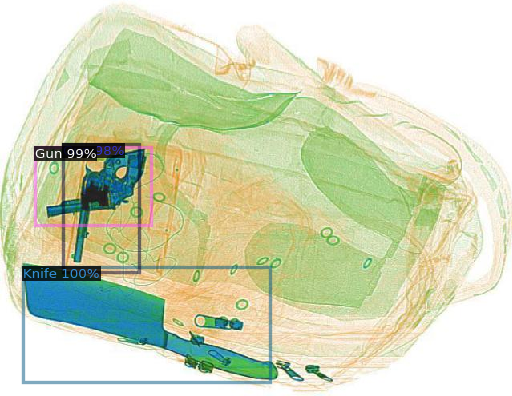

{'instances': Instances(num_instances=3, image_height=482, image_width=640, fields=[pred_boxes: Boxes(tensor([[ 36.1007, 175.4892, 138.9837, 312.6493],
        [ 16.2866, 158.5231, 186.9551, 271.5327],
        [ 10.8848, 169.9855,  77.7082, 440.4485]], device='cuda:0')), scores: tensor([0.9976, 0.9949, 0.9937], device='cuda:0'), pred_classes: tensor([1, 1, 2], device='cuda:0')])}


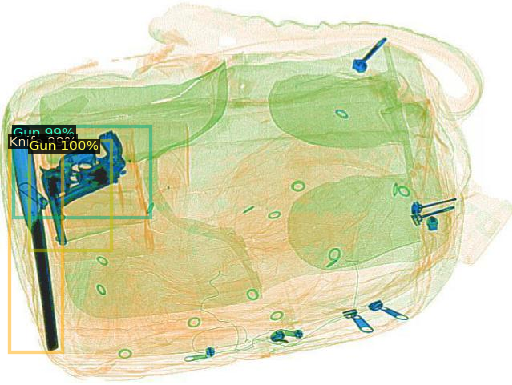

{'instances': Instances(num_instances=4, image_height=501, image_width=640, fields=[pred_boxes: Boxes(tensor([[409.3019, 185.5483, 612.5040, 305.0840],
        [451.7178, 244.6685, 545.7705, 410.3074],
        [556.4442,  68.4945, 596.3429, 434.0093],
        [416.6209, 163.2758, 589.5056, 402.7031]], device='cuda:0')), scores: tensor([0.9956, 0.9935, 0.8790, 0.8270], device='cuda:0'), pred_classes: tensor([1, 1, 2, 1], device='cuda:0')])}


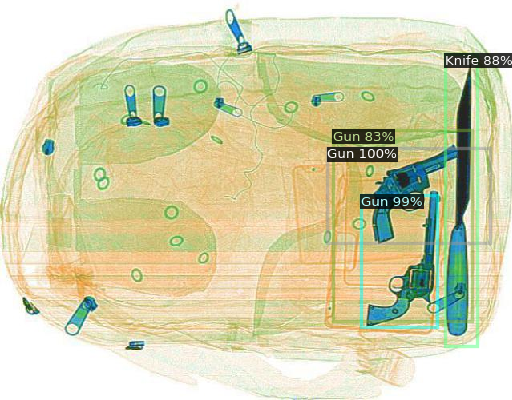

{'instances': Instances(num_instances=4, image_height=544, image_width=640, fields=[pred_boxes: Boxes(tensor([[ 65.9075, 256.6586, 169.7907, 353.5406],
        [177.4713, 262.9547, 304.4588, 378.7675],
        [ 34.2564, 323.8445, 246.1952, 526.2217],
        [ 15.6667, 277.0691, 181.3421, 475.7279]], device='cuda:0')), scores: tensor([0.9994, 0.9985, 0.9971, 0.6231], device='cuda:0'), pred_classes: tensor([1, 1, 2, 2], device='cuda:0')])}


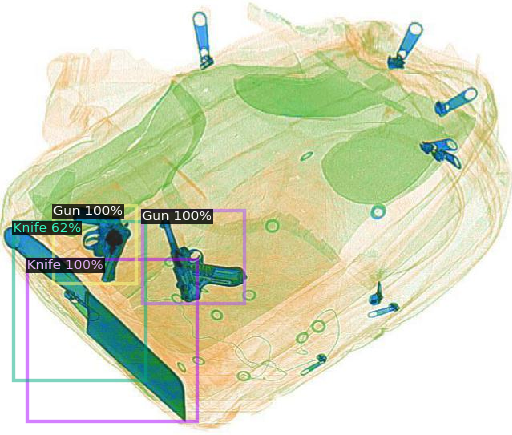

{'instances': Instances(num_instances=3, image_height=508, image_width=640, fields=[pred_boxes: Boxes(tensor([[ 17.4816, 274.3428, 167.3133, 389.8654],
        [165.8059, 190.9568, 282.7943, 334.3784],
        [  9.0986,  51.9079,  85.8309, 417.0847]], device='cuda:0')), scores: tensor([0.9992, 0.9988, 0.9963], device='cuda:0'), pred_classes: tensor([1, 1, 2], device='cuda:0')])}


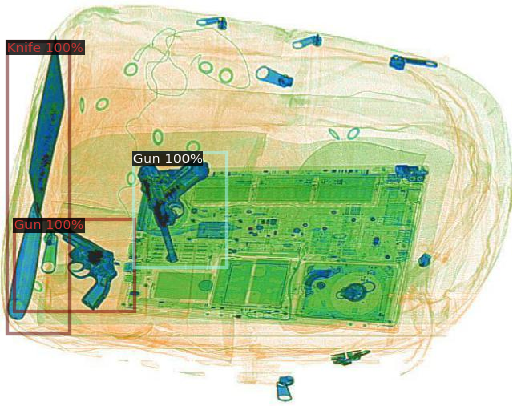

{'instances': Instances(num_instances=2, image_height=468, image_width=640, fields=[pred_boxes: Boxes(tensor([[  3.4001, 128.7352, 173.6506, 249.6701],
        [  3.1774, 136.1120,  81.8675, 440.1678]], device='cuda:0')), scores: tensor([0.9991, 0.9955], device='cuda:0'), pred_classes: tensor([1, 2], device='cuda:0')])}


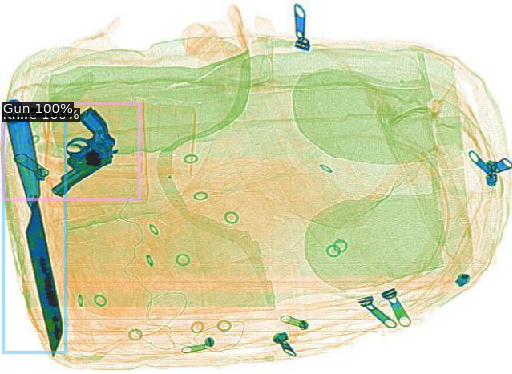

{'instances': Instances(num_instances=4, image_height=433, image_width=640, fields=[pred_boxes: Boxes(tensor([[429.3895, 239.6036, 640.0000, 369.5638],
        [251.5268, 101.6122, 374.0488, 304.6042],
        [579.6263,  88.7425, 614.0292, 414.4020],
        [263.4044,   7.3665, 348.0853,  72.2091]], device='cuda:0')), scores: tensor([0.9962, 0.9912, 0.8606, 0.5435], device='cuda:0'), pred_classes: tensor([1, 1, 2, 1], device='cuda:0')])}


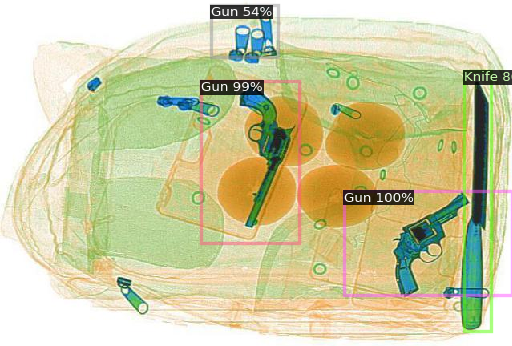

{'instances': Instances(num_instances=3, image_height=502, image_width=640, fields=[pred_boxes: Boxes(tensor([[265.1888, 260.1473, 396.4796, 437.0768],
        [405.2084, 166.8879, 632.7797, 289.5600],
        [569.8484, 106.8106, 618.9627, 414.8260]], device='cuda:0')), scores: tensor([0.9983, 0.9972, 0.9786], device='cuda:0'), pred_classes: tensor([1, 1, 2], device='cuda:0')])}


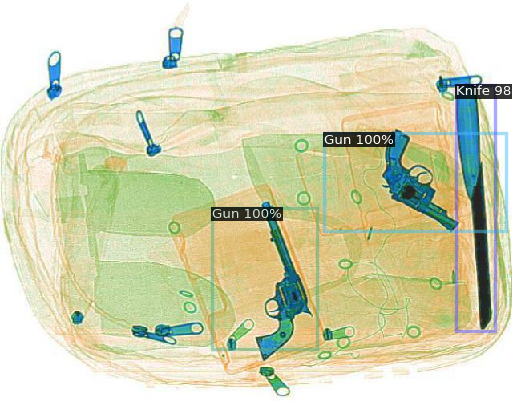

{'instances': Instances(num_instances=2, image_height=505, image_width=640, fields=[pred_boxes: Boxes(tensor([[247.2718,   2.9717, 451.5114, 126.1249],
        [ 31.3044,  52.6524, 153.3153, 264.8463]], device='cuda:0')), scores: tensor([0.9992, 0.8842], device='cuda:0'), pred_classes: tensor([1, 1], device='cuda:0')])}


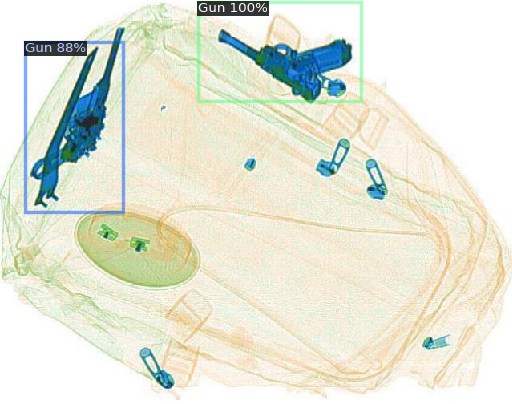

{'instances': Instances(num_instances=2, image_height=640, image_width=464, fields=[pred_boxes: Boxes(tensor([[175.2596, 210.9660, 283.1474, 372.2539],
        [296.6434, 414.9640, 449.7486, 560.2163]], device='cuda:0')), scores: tensor([0.9978, 0.9974], device='cuda:0'), pred_classes: tensor([1, 1], device='cuda:0')])}


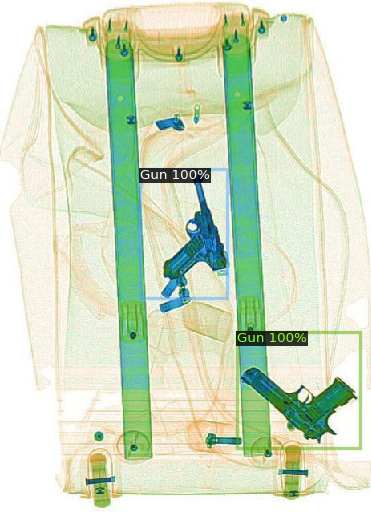

{'instances': Instances(num_instances=2, image_height=382, image_width=640, fields=[pred_boxes: Boxes(tensor([[256.8701, 137.7520, 397.9793, 229.9773],
        [ 46.4143, 230.2400, 196.8342, 346.2209]], device='cuda:0')), scores: tensor([0.9984, 0.9969], device='cuda:0'), pred_classes: tensor([1, 1], device='cuda:0')])}


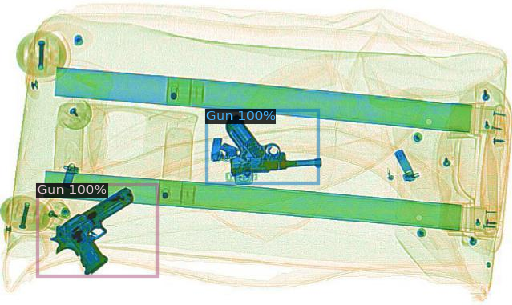

{'instances': Instances(num_instances=1, image_height=585, image_width=640, fields=[pred_boxes: Boxes(tensor([[358.9743, 228.2805, 525.3521, 319.5299]], device='cuda:0')), scores: tensor([0.9986], device='cuda:0'), pred_classes: tensor([1], device='cuda:0')])}


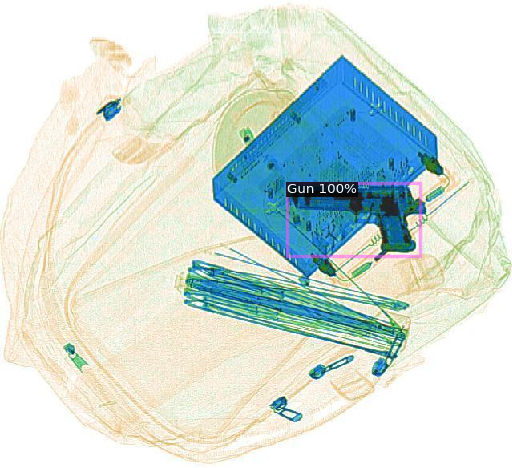

{'instances': Instances(num_instances=1, image_height=497, image_width=640, fields=[pred_boxes: Boxes(tensor([[189.0361, 160.1420, 332.8450, 286.8519]], device='cuda:0')), scores: tensor([0.9919], device='cuda:0'), pred_classes: tensor([1], device='cuda:0')])}


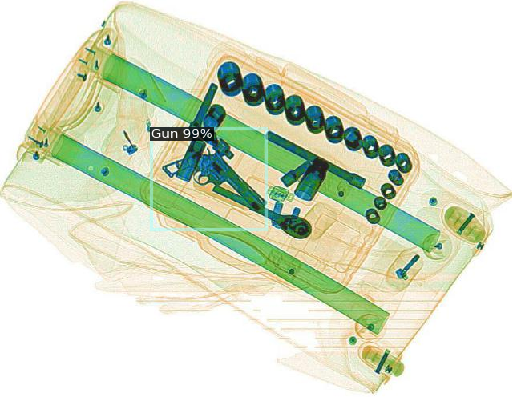

{'instances': Instances(num_instances=2, image_height=510, image_width=640, fields=[pred_boxes: Boxes(tensor([[304.0772, 211.7816, 441.3380, 311.0667],
        [209.8808, 286.8269, 322.0041, 365.7726]], device='cuda:0')), scores: tensor([0.9997, 0.7329], device='cuda:0'), pred_classes: tensor([1, 1], device='cuda:0')])}


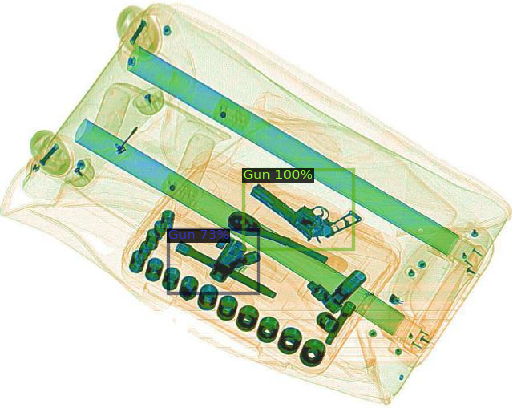

{'instances': Instances(num_instances=1, image_height=640, image_width=569, fields=[pred_boxes: Boxes(tensor([[390.8232, 130.1332, 519.3097, 358.1641]], device='cuda:0')), scores: tensor([0.9985], device='cuda:0'), pred_classes: tensor([1], device='cuda:0')])}


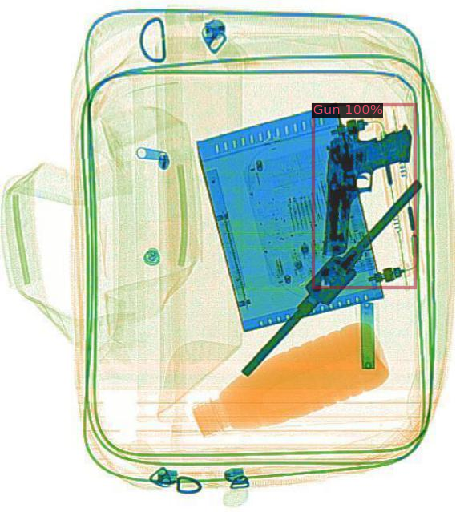

{'instances': Instances(num_instances=1, image_height=539, image_width=640, fields=[pred_boxes: Boxes(tensor([[197.4317, 239.2404, 341.6212, 307.9780]], device='cuda:0')), scores: tensor([0.9966], device='cuda:0'), pred_classes: tensor([1], device='cuda:0')])}


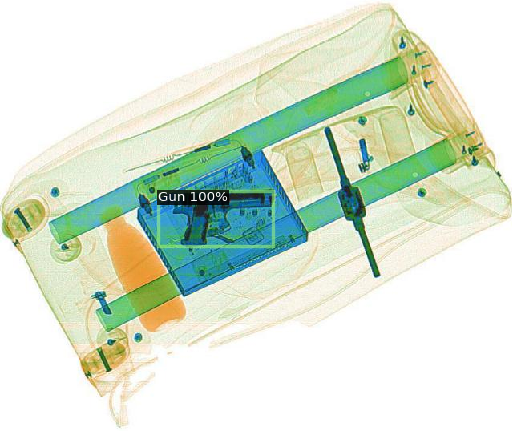

{'instances': Instances(num_instances=1, image_height=409, image_width=640, fields=[pred_boxes: Boxes(tensor([[293.3915, 136.1804, 460.7081, 241.0589]], device='cuda:0')), scores: tensor([0.9988], device='cuda:0'), pred_classes: tensor([1], device='cuda:0')])}


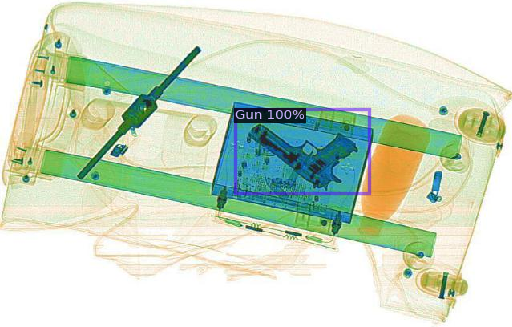

{'instances': Instances(num_instances=1, image_height=507, image_width=640, fields=[pred_boxes: Boxes(tensor([[269.7080, 243.8008, 409.3762, 317.9904]], device='cuda:0')), scores: tensor([0.9986], device='cuda:0'), pred_classes: tensor([1], device='cuda:0')])}


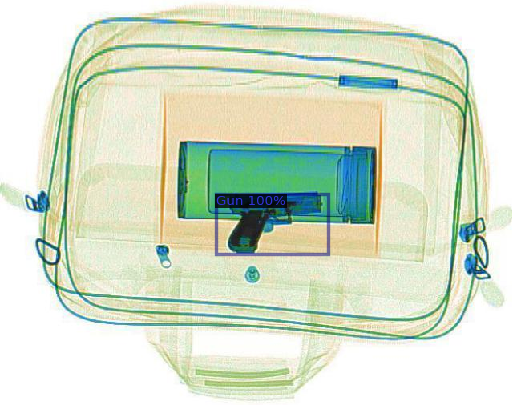

{'instances': Instances(num_instances=2, image_height=640, image_width=447, fields=[pred_boxes: Boxes(tensor([[111.8471, 382.5500, 260.6809, 503.6201],
        [255.7497, 109.7230, 374.0249, 276.2760]], device='cuda:0')), scores: tensor([0.9990, 0.9990], device='cuda:0'), pred_classes: tensor([1, 1], device='cuda:0')])}


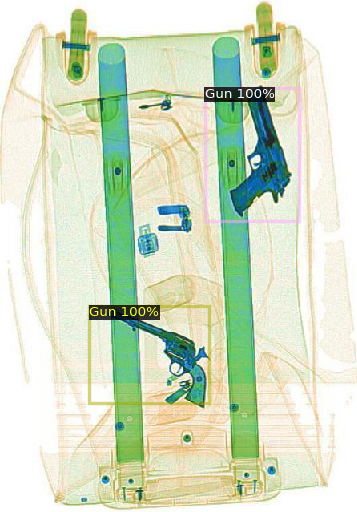

{'instances': Instances(num_instances=1, image_height=412, image_width=640, fields=[pred_boxes: Boxes(tensor([[207.6825, 149.6023, 370.0244, 243.5059]], device='cuda:0')), scores: tensor([0.9970], device='cuda:0'), pred_classes: tensor([1], device='cuda:0')])}


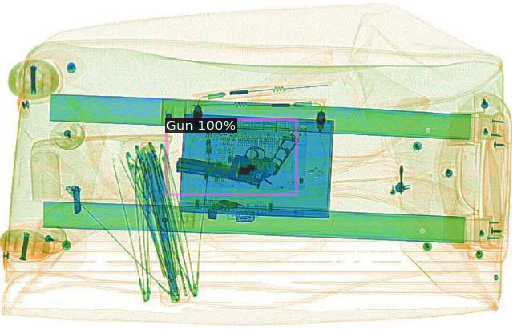

{'instances': Instances(num_instances=1, image_height=531, image_width=640, fields=[pred_boxes: Boxes(tensor([[306.9364, 262.4374, 465.2622, 389.2775]], device='cuda:0')), scores: tensor([0.9994], device='cuda:0'), pred_classes: tensor([1], device='cuda:0')])}


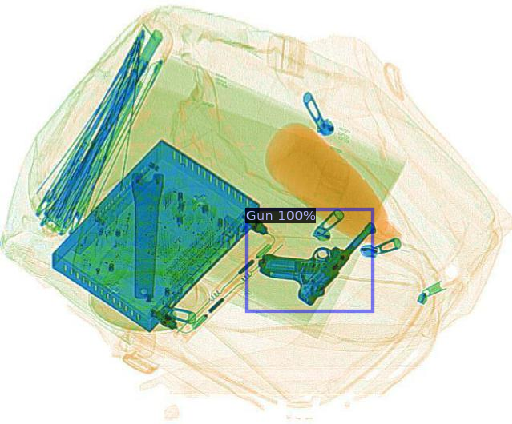

{'instances': Instances(num_instances=1, image_height=548, image_width=640, fields=[pred_boxes: Boxes(tensor([[ 72.1987, 241.2312, 258.6241, 369.7480]], device='cuda:0')), scores: tensor([0.9970], device='cuda:0'), pred_classes: tensor([1], device='cuda:0')])}


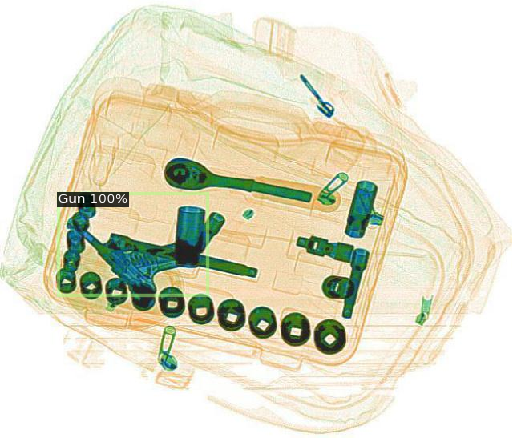

{'instances': Instances(num_instances=2, image_height=640, image_width=607, fields=[pred_boxes: Boxes(tensor([[255.9974, 442.5374, 457.1659, 561.7041],
        [206.9926,  64.5807, 387.8547, 253.6736]], device='cuda:0')), scores: tensor([0.9992, 0.9971], device='cuda:0'), pred_classes: tensor([1, 1], device='cuda:0')])}


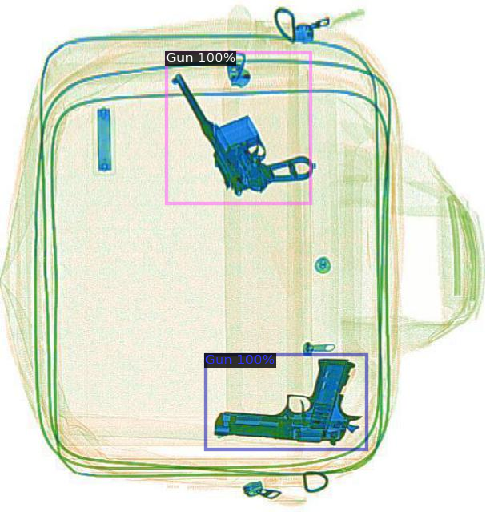

{'instances': Instances(num_instances=8, image_height=591, image_width=640, fields=[pred_boxes: Boxes(tensor([[ 88.5876,  62.3079, 259.6649, 240.2108],
        [251.8794, 190.9873, 435.6837, 326.2583],
        [283.2418,  84.1828, 467.3974, 215.2888],
        [ 64.0717, 322.8816, 268.9790, 445.8524],
        [144.2473, 230.9137, 331.0909, 369.6757],
        [283.6970, 294.9879, 486.6520, 372.0086],
        [276.9730, 249.7459, 439.9938, 368.3305],
        [201.0726, 213.4048, 386.2833, 345.2230]], device='cuda:0')), scores: tensor([0.9985, 0.9979, 0.9976, 0.9976, 0.9973, 0.9948, 0.5573, 0.5561],
       device='cuda:0'), pred_classes: tensor([1, 1, 1, 1, 1, 1, 1, 1], device='cuda:0')])}


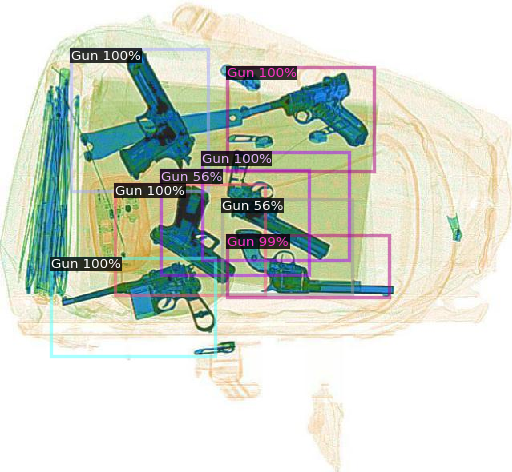

{'instances': Instances(num_instances=1, image_height=637, image_width=640, fields=[pred_boxes: Boxes(tensor([[283.7812, 296.4540, 427.3736, 415.2490]], device='cuda:0')), scores: tensor([0.9986], device='cuda:0'), pred_classes: tensor([1], device='cuda:0')])}


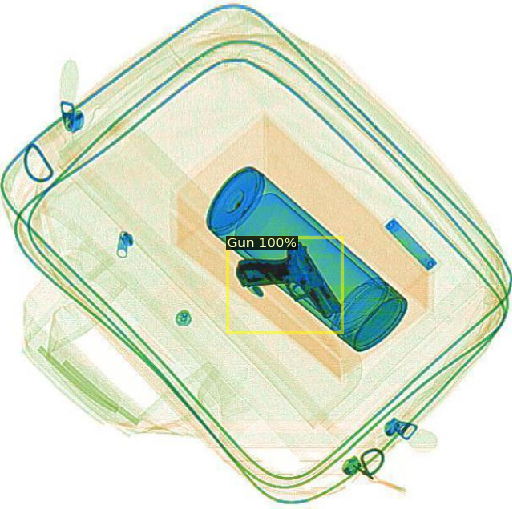

{'instances': Instances(num_instances=1, image_height=626, image_width=640, fields=[pred_boxes: Boxes(tensor([[316.1586, 341.2214, 478.3531, 483.8056]], device='cuda:0')), scores: tensor([0.9998], device='cuda:0'), pred_classes: tensor([1], device='cuda:0')])}


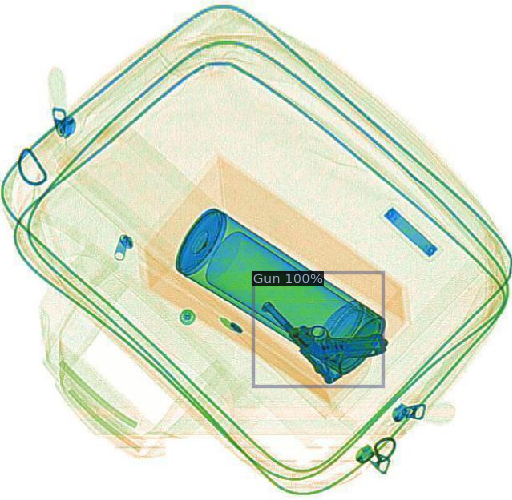

{'instances': Instances(num_instances=2, image_height=640, image_width=423, fields=[pred_boxes: Boxes(tensor([[ 46.5342, 342.3351, 144.2987, 501.4163],
        [171.0957, 126.3582, 323.1196, 271.8086]], device='cuda:0')), scores: tensor([0.9992, 0.9916], device='cuda:0'), pred_classes: tensor([1, 1], device='cuda:0')])}


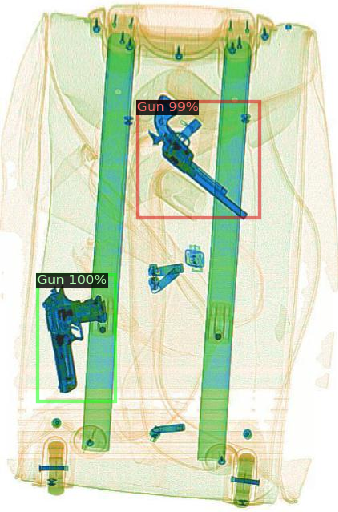

{'instances': Instances(num_instances=1, image_height=640, image_width=602, fields=[pred_boxes: Boxes(tensor([[296.2560, 124.6656, 459.0063, 311.0811]], device='cuda:0')), scores: tensor([0.9981], device='cuda:0'), pred_classes: tensor([1], device='cuda:0')])}


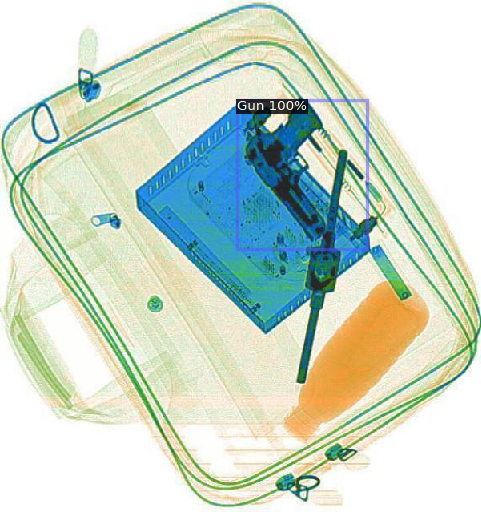

{'instances': Instances(num_instances=1, image_height=476, image_width=640, fields=[pred_boxes: Boxes(tensor([[365.7625, 127.7772, 503.7152, 251.0670]], device='cuda:0')), scores: tensor([0.9979], device='cuda:0'), pred_classes: tensor([1], device='cuda:0')])}


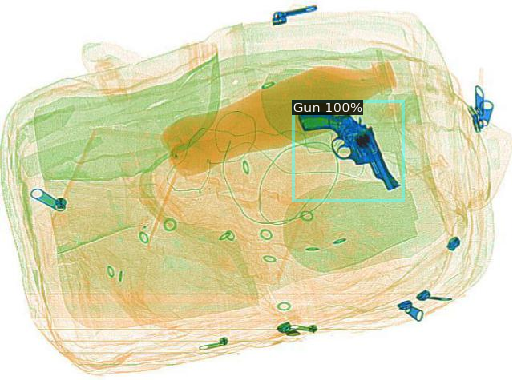

{'instances': Instances(num_instances=4, image_height=451, image_width=640, fields=[pred_boxes: Boxes(tensor([[284.8842,  80.1557, 481.2690, 187.0732],
        [ 14.1973,  47.2063, 384.0208, 285.3742],
        [ 26.8908, 235.6444, 122.8341, 379.5958],
        [ 22.5039,  25.0514, 242.8694, 222.2654]], device='cuda:0')), scores: tensor([0.9926, 0.9907, 0.9874, 0.5853], device='cuda:0'), pred_classes: tensor([1, 2, 1, 2], device='cuda:0')])}


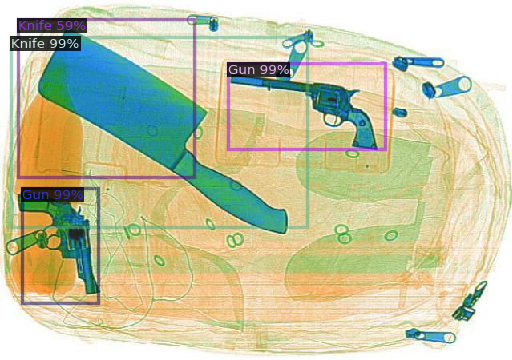

{'instances': Instances(num_instances=1, image_height=394, image_width=640, fields=[pred_boxes: Boxes(tensor([[104.9958, 264.0641, 243.8867, 337.8102]], device='cuda:0')), scores: tensor([0.9998], device='cuda:0'), pred_classes: tensor([1], device='cuda:0')])}


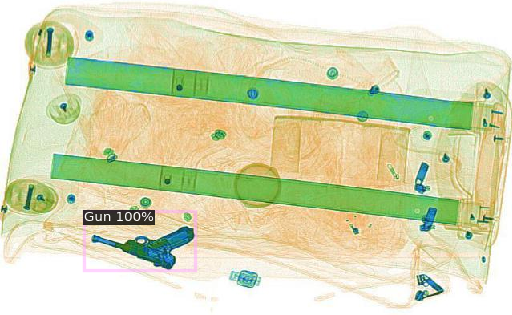

{'instances': Instances(num_instances=1, image_height=434, image_width=640, fields=[pred_boxes: Boxes(tensor([[409.4746, 152.4343, 542.5707, 229.3543]], device='cuda:0')), scores: tensor([0.9983], device='cuda:0'), pred_classes: tensor([1], device='cuda:0')])}


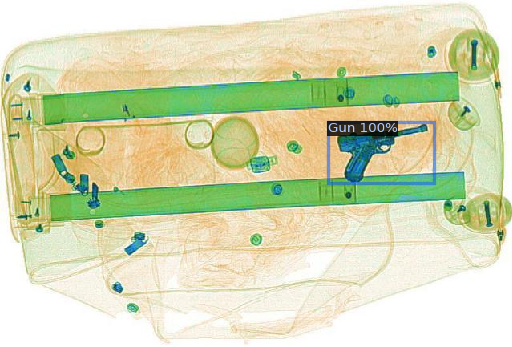

{'instances': Instances(num_instances=1, image_height=461, image_width=640, fields=[pred_boxes: Boxes(tensor([[ 35.0712,  77.8295, 183.1803, 141.3035]], device='cuda:0')), scores: tensor([0.9975], device='cuda:0'), pred_classes: tensor([1], device='cuda:0')])}


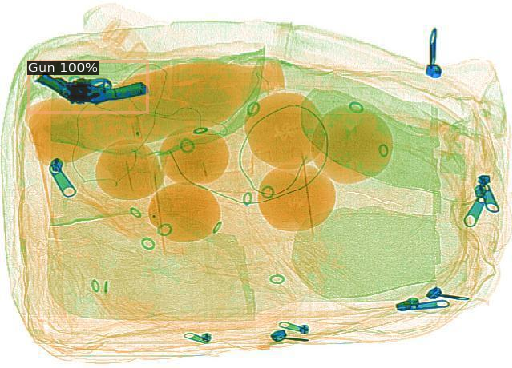

In [ ]:
from detectron2.utils.visualizer import ColorMode, Visualizer
import glob
import cv2
from google.colab.patches import cv2_imshow

# Path to your test images
image_paths = glob.glob('/content/drive/MyDrive/cocopuffs/testcoco/combined/*jpg')

for imageName in image_paths:
    im = cv2.imread(imageName)
    outputs = predictor(im)

    # Check the outputs to ensure predictions are being made
    print(outputs)

    # Visualize the predictions
    v = Visualizer(
        im[:, :, ::-1],
        metadata=test_metadata,
        scale=0.8,
        instance_mode=ColorMode.IMAGE  # Change to ColorMode.IMAGE_BW if you want black & white
    )
    out = v.draw_instance_predictions(outputs["instances"].to("cpu"))

    # Display the image with bounding boxes and class names
    cv2_imshow(out.get_image()[:, :, ::-1])


In [ ]:
import os
import json
import glob
import cv2
from detectron2.utils.visualizer import Visualizer
from detectron2.data import MetadataCatalog

# Define class names (should be the same as those used during training)
class_names = ['TIP', 'Gun', 'Knife'] # Replace with your actual class names

# Add class names to the metadata
test_metadata = MetadataCatalog.get("my_dataset_test")
test_metadata.thing_classes = class_names

# Path to your test images
image_paths = glob.glob('/content/drive/MyDrive/cocopuffs/testcoco/combined/*jpg')

# Create a list to hold the annotation data
annotations = []
images = []

# Iterate over the images and make predictions
for idx, imageName in enumerate(image_paths):
    im = cv2.imread(imageName)
    outputs = predictor(im)

    # Prepare the image data entry
    height, width = im.shape[:2]
    image_entry = {
        "id": idx,
        "file_name": os.path.basename(imageName),
        "height": height,
        "width": width
    }
    images.append(image_entry)

    # Iterate over the predictions
    instances = outputs["instances"].to("cpu")
    boxes = instances.pred_boxes.tensor.numpy()
    scores = instances.scores.numpy()
    classes = instances.pred_classes.numpy()

    for box, score, cls in zip(boxes, scores, classes):
        x_min, y_min, x_max, y_max = box
        width = x_max - x_min
        height = y_max - y_min

        annotation = {
            "id": len(annotations),
            "image_id": idx,
            "category_id": int(cls) + 1,  # Category ID should start from 1 in COCO format
            "bbox": [float(x_min), float(y_min), float(width), float(height)],
            "area": float(width * height),
            "segmentation": [],
            "iscrowd": 0,
            "score": float(score)  # Include the score if needed
        }
        annotations.append(annotation)

# Prepare the categories
categories = []
for idx, class_name in enumerate(class_names):
    category = {
        "id": idx + 1,
        "name": class_name,
        "supercategory": "none"
    }
    categories.append(category)

# Prepare the final COCO format data
coco_format = {
    "images": images,
    "annotations": annotations,
    "categories": categories
}

# Save to JSON file
output_file = '/content/predictions_coco_format.json'
with open(output_file, 'w') as f:
    json.dump(coco_format, f)

print(f"COCO format predictions saved to {output_file}")


COCO format predictions saved to /content/predictions_coco_format.json
